# マンガデータの内訳を見る

## 準備

### Import

In [1]:
# warningsモジュールのインポート
import warnings

# データ解析や機械学習のライブラリ使用時の警告を非表示にする目的で警告を無視
# 本書の文脈では、可視化の学習に議論を集中させるために選択した
# ただし、学習以外の場面で、警告を無視する設定は推奨しない
warnings.filterwarnings("ignore")

In [3]:
# itertoolsモジュールのインポート
# 様々なパターンのループを効率的に実行可能
import itertools

# osモジュールのインポート
# オペレーティングシステムとのインターフェースを提供
import os

# pathlibモジュールのインポート
# ファイルシステムのパスを扱う
from pathlib import Path

# typingモジュールからの型ヒント関連のインポート
# 関数やクラスの引数・返り値の型を注釈するためのツール
from typing import Any, Dict, List, Optional, Union

# numpy：数値計算ライブラリのインポート
# npという名前で参照可能
import numpy as np

# pandas：データ解析ライブラリのインポート
# pdという名前で参照可能
import pandas as pd

# plotly.expressのインポート
# インタラクティブなグラフ作成のライブラリ
# pxという名前で参照可能
import plotly.express as px

# plotly.graph_objectsのインポート
# より詳細なグラフ作成機能を利用可能
# goという名前で参照可能
import plotly.graph_objects as go

# plotly.graph_objectsからFigureクラスのインポート
# 型ヒントの利用を主目的とする
from plotly.graph_objects import Figure

### 変数

In [4]:
# マンガデータが保存されているディレクトリのパス
DIR_IN = Path("../../../data/cm/input")

# 分析結果の出力先ディレクトリのパス
DIR_OUT = (
    DIR_IN.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "props"
)

In [5]:
# 読み込み対象ファイル名の定義

# マンガ各話に関するファイル
FN_CE = "cm_ce.csv"

# マンガ作品と原作者の対応関係に関するファイル
FN_CC_CRT = "cm_cc_crt.csv"

In [6]:
# 可視化に関する設定値を定義

# weekdayを曜日に変換するための辞書
WD2STR = {
    0: "月",
    1: "火",
    2: "水",
    3: "木",
    4: "金",
    5: "土",
    6: "日",
}

In [7]:
# plotlyの描画設定の定義

# plotlyのグラフ描画用レンダラーの定義
# Jupyter Notebook環境のグラフ表示に適切なものを選択
RENDERER = "plotly_mimetype+notebook"

In [8]:
# 質的変数の描画用のカラースケールの定義

# Okabe and Ito (2008)基準のカラーパレット
# 色の識別性が高く、多様な色覚の人々にも見やすい色組み合わせ
# 参考URL: https://jfly.uni-koeln.de/color/#pallet
OKABE_ITO = [
    "#000000",  # 黒 (Black)
    "#E69F00",  # 橙 (Orange)
    "#56B4E9",  # 薄青 (Sky Blue)
    "#009E73",  # 青緑 (Bluish Green)
    "#F0E442",  # 黄色 (Yellow)
    "#0072B2",  # 青 (Blue)
    "#D55E00",  # 赤紫 (Vermilion)
    "#CC79A7",  # 紫 (Reddish Purple)
]

### 関数

In [9]:
def show_fig(fig: Figure) -> None:
    """
    所定のレンダラーを用いてplotlyの図を表示
    Jupyter Bookなどの環境での正確な表示を目的とする

    Parameters
    ----------
    fig : Figure
        表示対象のplotly図

    Returns
    -------
    None
    """

    # 図の周囲の余白を設定
    # t: 上余白
    # l: 左余白
    # r: 右余白
    # b: 下余白
    fig.update_layout(margin=dict(t=25, l=25, r=25, b=25))

    # 所定のレンダラーで図を表示
    fig.show(renderer=RENDERER)

In [10]:
def add_years_to_df(
    df: pd.DataFrame, unit_years: int = 10, col_date: str = "date"
) -> pd.DataFrame:
    """
    データフレームにunit_years単位で区切った年数を示す新しい列を追加

    Parameters
    ----------
    df : pd.DataFrame
        入力データフレーム
    unit_years : int, optional
        年数を区切る単位、デフォルトは10
    col_date : str, optional
        日付を含むカラム名、デフォルトは "date"

    Returns
    -------
    pd.DataFrame
        新しい列が追加されたデータフレーム
    """

    # 入力データフレームをコピー
    df_new = df.copy()

    # unit_years単位で年数を区切り、新しい列として追加
    df_new["years"] = (
        pd.to_datetime(df_new[col_date]).dt.year // unit_years * unit_years
    )

    # 'years'列のデータ型を文字列に変更
    df_new["years"] = df_new["years"].astype(str)

    return df_new

In [11]:
def add_weekday_to_df(df: pd.DataFrame, col_date: str = "date") -> pd.DataFrame:
    """
    指定されたDataFrameに曜日の情報を追加する関数

    Parameters
    ----------
    df : pd.DataFrame
        曜日情報を追加する対象のDataFrame
    col_date : str, optional
        日付情報が含まれているカラムの名前、デフォルトは "date"

    Returns
    -------
    pd.DataFrame
        曜日情報が追加された新しいDataFrame
    """

    # 元のDataFrameをコピーして新しいDataFrameを作成
    df_new = df.copy()

    # 日付カラムを元に曜日の数値を計算して新しいカラムに追加
    df_new["weekday"] = pd.to_datetime(df_new[col_date]).dt.weekday

    # 数値の曜日を文字列に変換して新しいカラムに追加
    df_new["weekday_str"] = df_new["weekday"].apply(lambda x: WD2STR[x])

    return df_new

In [12]:
def create_mosaicplot(
    df: pd.DataFrame,
    x: str,
    y: str,
    color: str,
    width: str,
    text: str,
    color_discrete_sequence: List[str] = OKABE_ITO,
) -> go.Figure:
    """
    指定されたDataFrameを元にモザイクプロットを作成する関数

    Parameters
    ----------
    df : pd.DataFrame
        プロットに使用するデータが含まれるDataFrame
    x : str
        x軸に表示するデータのカラム名
    y : str
        y軸に表示するデータのカラム名
    color : str
        グループ分けの基準となるデータのカラム名
    width : str
        各バーの幅を表すデータのカラム名
    text : str
        各バーに表示するテキストのデータのカラム名
    color_discrete_sequence : List[str], optional
        使用する色のリスト デフォルトはOKABE_ITOのカラーパレット

    Returns
    -------
    go.Figure
        作成されたモザイクプロットのFigureオブジェクト
    """

    # 空のFigureオブジェクトを作成
    fig = go.Figure()

    # color列に登場するユニークな要素に対し、色をマッピング
    unique_keys = df[color].unique()
    color_map = {
        name: color for name, color in zip(unique_keys, color_discrete_sequence)
    }

    # color列のユニークな要素ごとにDataFrameをフィルタリング
    for i, name in enumerate(unique_keys):
        df_tmp = df[df[color] == name].reset_index(drop=True)
        # 幅をwidth列から抽出
        widths = df_tmp[width]

        # バーの位置を計算し、プロットに追加
        # 幅が変わるようxの値を調整
        fig.add_trace(
            go.Bar(
                name=name,
                x=df_tmp[width].cumsum() - widths,
                y=df_tmp[y],
                text=df_tmp[text],
                width=widths,
                offset=0,
                marker_color=color_map[name],
            )
        )

        # 最初の要素を用いて、X軸ラベルの設定値を作成
        if i == 0:
            # 各「棒」の中央に配置されるように座標を計算
            tickvals = df_tmp[width].cumsum() - df_tmp[width] / 2
            ticktext = df_tmp[x].unique()
            # x軸の表示範囲を決定するために利用
            x_max = df_tmp[width].sum()

    # x軸の目盛りの位置、テキスト、表示範囲を設定
    # 「棒」の太さの合計値を1としたとき、左右に0.1ずつ余白が残るように調整
    fig.update_xaxes(
        tickvals=tickvals, ticktext=ticktext, title=x, range=[-x_max * 0.1, x_max * 1.1]
    )

    # y軸のタイトルを設定
    fig.update_yaxes(title=y)

    # プロットのレイアウトを設定、凡例タイトルも指定
    fig.update_layout(barmode="stack", legend_title=color)

    return fig

In [13]:
def format_cols(df: pd.DataFrame, cols_rename: Dict[str, str]) -> pd.DataFrame:
    """
    指定されたカラムのみをデータフレームから抽出し、カラム名をリネームする関数

    Parameters
    ----------
    df : pd.DataFrame
        入力データフレーム
    cols_rename : Dict[str, str]
        リネームしたいカラム名のマッピング（元のカラム名: 新しいカラム名）

    Returns
    -------
    pd.DataFrame
        カラムが抽出・リネームされたデータフレーム
    """

    # 指定されたカラムのみを抽出し、リネーム
    df = df[cols_rename.keys()].rename(columns=cols_rename)

    return df

In [14]:
def save_df_to_csv(df: pd.DataFrame, dir_save: Path, fn_save: str) -> None:
    """
    DataFrameをCSVファイルとして指定されたディレクトリに保存する関数

    Parameters
    ----------
    df : pd.DataFrame
        保存対象となるDataFrame
    dir_save : Path
        出力先ディレクトリのパス
    fn_save : str
        保存するCSVファイルの名前（拡張子は含めない）
    """
    # 出力先ディレクトリが存在しない場合は作成
    dir_save.mkdir(parents=True, exist_ok=True)

    # 出力先のパスを作成
    p_save = dir_save / f"{fn_save}.csv"

    # DataFrameをCSVファイルとして保存する
    df.to_csv(p_save, index=False, encoding="utf-8-sig")

    # 保存完了のメッセージを表示する
    print(f"DataFrame is saved as '{p_save}'.")

## 可視化例

In [15]:
# pandasのread_csv関数でCSVファイルの読み込み
df_ce = pd.read_csv(DIR_IN / FN_CE)
df_cc_crt = pd.read_csv(DIR_IN / FN_CC_CRT)

(cm-pie)=
### 円グラフ

In [16]:
# 5ページ以上掲載されたccidのリストを作成
ccids_by_pages = df_ce[df_ce["pages"] >= 5]["ccid"].unique()

# 合計マンガ作者数が1のccidのリストを作成するために、まずccid別のマンガ作者数を集計
df_ccid_ncrt = df_cc_crt.groupby("ccid")["crtid"].nunique().reset_index(name="n_crt")
# その上で、n_crt（マンガ作者数）が1の作品のみ抽出してリスト化
ccids_by_ncrt = df_ccid_ncrt[df_ccid_ncrt["n_crt"] == 1]["ccid"].unique()

# ccids_by_pagesとccids_by_ncrtの両方の条件を満たすccidsを作成
ccids = set(ccids_by_pages) & set(ccids_by_ncrt)

# 上記を満たすマンガ作品のうち、合計話数が1であるものを抽出
df_oneshot = df_cc_crt[
    (df_cc_crt["ccid"].isin(ccids)) & (df_cc_crt["n_ce"] == 1)
].reset_index(drop=True)
# マージ用に抽出する列
cols4merge = ["first_date", "ccid", "ccname", "mcname"]
# 更に、マンガ作者ごとに最も古いものを抽出するためにfirst_dateでソート
df_oneshot = df_oneshot.sort_values("first_date", ignore_index=True)
# crtid別にグルーピングし、先頭の行のcrtnameとcols4mergeのみ抽出
df_first_oneshot = (
    df_oneshot.groupby(["crtid"])[["crtname"] + cols4merge].first().reset_index()
)

# マージ用にカラム名を変更、先頭にoneshotをつける
df_first_oneshot = df_first_oneshot.rename(
    columns={c: f"oneshot_{c}" for c in cols4merge}
)

In [17]:
# 合計各話数が8話以上のマンガ作品とマンガ作者の組合せを抽出
df_series = df_cc_crt[df_cc_crt["n_ce"] >= 8].reset_index(drop=True)
# 更に、マンガ作者ごとに最も古いものを抽出するためにfirst_dateでソート
df_series = df_series.sort_values("first_date", ignore_index=True)
# crtid別にグルーピングし、先頭の行のcols4mergeのみ抽出
df_first_series = df_series.groupby("crtid")[cols4merge].first().reset_index()

# マージ用にカラム名を変更、先頭にseriesをつける
df_first_series = df_first_series.rename(columns={c: f"series_{c}" for c in cols4merge})

In [18]:
# crtidを基準にdf_first_oneshotとdf_first_seriesをleft join
df_merge = pd.merge(df_first_oneshot, df_first_series, on="crtid", how="left")

# 読切マンガ作品掲載後に連載マンガ作品に繋がったと考えられるマンガ作者
df_crt_serialized = df_merge[
    df_merge["oneshot_first_date"] < df_merge["series_first_date"]
].reset_index(drop=True)
# そうでないと考えられるマンガ作者
df_crt_notyet = df_merge[df_merge["series_ccid"].isna()].reset_index(drop=True)

# 全ての読切マンガ掲載経験のあるマンガ作者をconcat、ただしignore_indexすることでindexを貼りなおす
df_crt_oneshot = pd.concat([df_crt_serialized, df_crt_notyet], ignore_index=True)

In [19]:
# 作図用に二つのDataFrameを集計
df_pie = pd.DataFrame(
    [
        {"連載化": "済", "マンガ作者数": df_crt_serialized["crtid"].nunique()},
        {"連載化": "未", "マンガ作者数": df_crt_notyet["crtid"].nunique()},
    ]
)

In [20]:
# 可視化対象のDataFrameを確認
df_pie.head()

,連載化,マンガ作者数
0,済,355
1,未,960


In [21]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_pie, DIR_OUT, "pie")

DataFrame is saved as '../../../data/cm/output/vol1/04/props/pie.csv'.


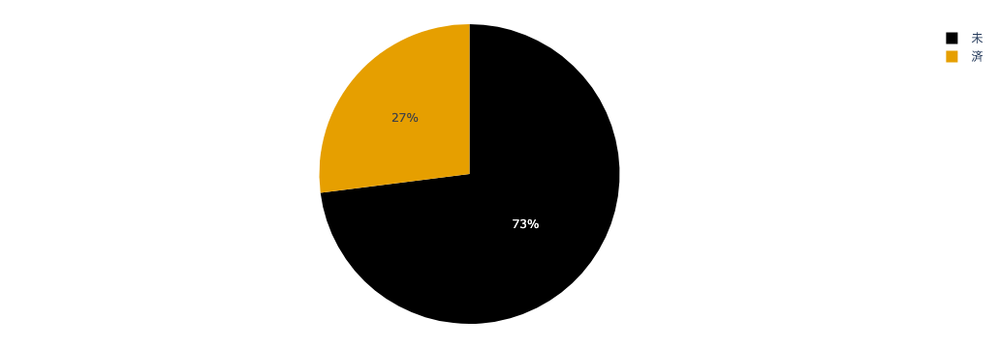

In [22]:
# df_pieデータフレームを使用して、'マンガ作者数'を値とし、'連載化'を名前として円グラフを作成
# OKABE_ITOカラーシーケンスを使用して色を指定
fig = px.pie(
    df_pie,
    values="マンガ作者数",
    names="連載化",
    color_discrete_sequence=OKABE_ITO,
)

# 作成した円グラフを表示
show_fig(fig)

In [23]:
# マンガ作者名が遠藤達哉と一致するレコードを抽出
df_crt_oneshot[df_crt_oneshot["crtname"] == "遠藤達哉"].T

,1214
crtid,CCRT03052
crtname,遠藤達哉
oneshot_first_date,2000-12-04
oneshot_ccid,C88617
oneshot_ccname,月華美人
oneshot_mcname,週刊少年ジャンプ
series_first_date,NaN
series_ccid,NaN
series_ccname,NaN
series_mcname,NaN


In [24]:
# マンガ作者名が山本崇一朗と一致するレコードを抽出
df_crt_oneshot[df_crt_oneshot["crtname"] == "山本崇一朗"].T

,809
crtid,CCRT01585
crtname,山本崇一朗
oneshot_first_date,2014-06-11
oneshot_ccid,C92613
oneshot_ccname,からかい上手の
oneshot_mcname,週刊少年サンデー
series_first_date,NaN
series_ccid,NaN
series_ccname,NaN
series_mcname,NaN


In [25]:
# マンガ作者名が三浦糀と一致するレコードを抽出
df_crt_oneshot[df_crt_oneshot["crtname"].str.contains("三浦糀")].T

,540
crtid,CCRT00629
crtname,三浦糀
oneshot_first_date,2017-06-07
oneshot_ccid,C115558
oneshot_ccname,先生、好きです。
oneshot_mcname,週刊少年マガジン
series_first_date,NaN
series_ccid,NaN
series_ccname,NaN
series_mcname,NaN


(cm-sbar-props)=
### 積上げ棒グラフ

In [26]:
# 連載マンガ作品として扱う最小のマンガ各話数を、マンガデータの基礎分析を踏まえ設定
min_nce = 8

# 'ccid'でグループ化し、各ccnameについてユニークなceidの数をカウント
df_cc_nce = df_ce.groupby(["ccid"])["ceid"].nunique().reset_index(name="n_ce")
# n_ceの値がmin_nce以上の行だけを保持
df_cc_nce = df_cc_nce[df_cc_nce["n_ce"] >= min_nce].reset_index(drop=True)
# n_ceの値でデータフレームを昇順にソート
df_cc_nce = df_cc_nce.sort_values("n_ce", ignore_index=True)

In [27]:
# df_ceを日付とceidでソートし、各ccidについて最初のmin_nce件のデータを取り出す
df_cc_n4c = (
    df_ce.sort_values(["date", "ceid"], ignore_index=True).groupby("ccid").head(min_nce)
)

# df_cc_nceのccid列に含まれるccidの行だけを保持
df_cc_n4c = df_cc_n4c[df_cc_n4c["ccid"].isin(df_cc_nce["ccid"].unique())]

# ccidごとにfour_coloredの数を集計
df_cc_n4c = (
    df_cc_n4c.groupby(["mcname", "ccname", "ccid"])["four_colored"]
    .sum()
    .reset_index(name="n_4c")
)

In [28]:
# min_nce、四分位数、最大値+1を使ってデータの範囲（threshold）を示すリストths_ceを作成
# 後に登場するfor文をきれいに書くために、min_nceと、n_ceの最大値+1を追加
ths_ce = (
    [min_nce]  # min_nceをリストの最初に追加
    + list(df_cc_nce["n_ce"].quantile([0.25, 0.5, 0.75]).astype(int))  # 四分位数を追加
    + [df_cc_nce["n_ce"].max() + 1]  # 最大値+1をリストの最後に追加
)

# ccidをグループ名にマップするための辞書を初期化
ccid2gname = {}

# ths_ceリスト内の閾値ペアをループして処理
for i in range(len(ths_ce) - 1):
    # 現在の閾値を下限、次の閾値を上限として設定
    lower = ths_ce[i]
    upper = ths_ce[i + 1]

    # n_ceが現在の閾値範囲内にある行だけを抽出してdf_qに保存
    df_q = df_cc_nce[(df_cc_nce["n_ce"] >= lower) & (df_cc_nce["n_ce"] < upper)]

    # ccidとグループ名をマッピングする辞書を作成
    gname = f"第{i+1}群（合計{lower}-{upper-1}話）"
    ccid2gname.update({ccid: gname for ccid in df_q["ccid"]})

In [29]:
# df_barのccnameに基づきにグループ名をマッピング
df_cc_n4c["gname"] = df_cc_n4c["ccid"].map(ccid2gname)

# gnameとmcnameでdf_barをソート
df_cc_n4c = df_cc_n4c.sort_values(["gname", "mcname"], ignore_index=True)

In [30]:
# 4色カラーのデータを集計
# "gname"でグループ化し、"n_4c"の合計と件数を計算
df_color = df_cc_n4c.groupby("gname")["n_4c"].agg(["sum", "count"]).reset_index()
# カラータイプとして"4色カラー"を追加
df_color["color_type"] = "4色カラー"

# モノクロのデータを作成
df_mono = df_color.copy()
# モノクロの各話数は、min_nce * 件数から4色カラーの合計を引いたもの
df_mono["sum"] = df_mono["count"] * min_nce - df_mono["sum"]
# カラータイプに"モノクロ"を追加
df_mono["color_type"] = "モノクロ"

# 4色カラーとモノクロのデータを結合
df_sbar = pd.concat([df_color, df_mono], ignore_index=True)

# 平均話数と割合を計算
df_sbar["mean"] = df_sbar["sum"] / df_sbar["count"]
df_sbar["text"] = df_sbar["mean"].apply(lambda x: f"約{x:0.2}話")

# グループ名とカラータイプでソートし、インデックスをリセット
df_sbar = df_sbar.sort_values(["gname", "color_type"], ignore_index=True)

# 列名をよりわかりやすい名前に変更
df_sbar = df_sbar.rename(
    columns={
        "gname": "グループ名",
        "sum": f"{min_nce}話目までの合計各話数",
        "mean": f"{min_nce}話目までの平均話数",
        "color_type": "掲載形態",
    }
)

In [31]:
# 可視化対象のDataFrameを確認
df_sbar.head(10)

,グループ名,8話目までの合計各話数,count,掲載形態,8話目までの平均話数,text
0,第1群（合計8-16話）,569,578,4色カラー,0.984429,約0.98話
1,第1群（合計8-16話）,4055,578,モノクロ,7.015571,約7.0話
2,第2群（合計17-31話）,742,594,4色カラー,1.249158,約1.2話
3,第2群（合計17-31話）,4010,594,モノクロ,6.750842,約6.8話
4,第3群（合計32-81話）,814,617,4色カラー,1.319287,約1.3話
5,第3群（合計32-81話）,4122,617,モノクロ,6.680713,約6.7話
6,第4群（合計82-1968話）,830,606,4色カラー,1.369637,約1.4話
7,第4群（合計82-1968話）,4018,606,モノクロ,6.630363,約6.6話


In [32]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_sbar, DIR_OUT, "sbar")

DataFrame is saved as '../../../data/cm/output/vol1/04/props/sbar.csv'.


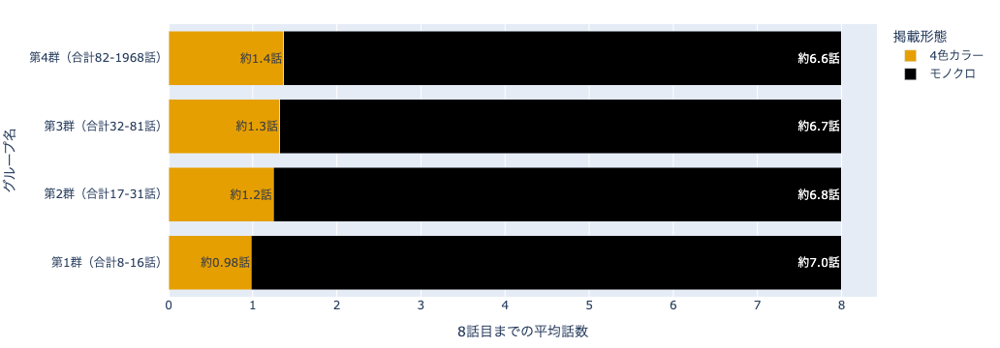

In [33]:
# df_sbarデータフレームを使用して積上げ棒グラフを作成
# f"{min_nce}話目までの平均話数"をx軸に、"グループ名"をy軸に設定
# 棒グラフのモードを"stack"（積み上げ）に設定し、"掲載形態"ごとに色分け
# 各棒には"text"をテキストとして表示
# 色はOKABE_ITOカラーパレットを利用するが、誤解を防ぐためモノクロが黒になるよう並び替え
# 棒グラフを水平方向に描画（orientation="h"）
fig = px.bar(
    df_sbar,
    x=f"{min_nce}話目までの平均話数",
    y="グループ名",
    barmode="stack",
    color="掲載形態",
    orientation="h",
    text="text",
    color_discrete_sequence=OKABE_ITO[:2][::-1],
)

# 作成した積上げ棒グラフを表示
show_fig(fig)

In [34]:
# 4色カラーのデータを集計
# "mcname"と"gname"でグループ化し、"n_4c"の合計と件数を計算
df_color = (
    df_cc_n4c.groupby(["mcname", "gname"])["n_4c"].agg(["sum", "count"]).reset_index()
)
# カラータイプとして"4色カラー"を追加
df_color["color_type"] = "4色カラー"

# モノクロのデータを作成
df_mono = df_color.copy()
# モノクロの各話数は、min_nce * 件数から4色カラーの合計を引いたもの
df_mono["sum"] = df_mono["count"] * min_nce - df_mono["sum"]
# カラータイプに"モノクロ"を追加
df_mono["color_type"] = "モノクロ"

# 4色カラーとモノクロのデータを結合
df_sbar2 = pd.concat([df_color, df_mono], ignore_index=True)

# 平均話数と割合を計算
df_sbar2["mean"] = df_sbar2["sum"] / df_sbar2["count"]
df_sbar2["text"] = df_sbar2["mean"].apply(lambda x: f"約{x:0.2}話")

# グループ名とカラータイプでソートし、インデックスをリセット
df_sbar2 = df_sbar2.sort_values(["mcname", "gname", "color_type"], ignore_index=True)

# 列名をよりわかりやすい名前に変更
df_sbar2 = df_sbar2.rename(
    columns={
        "mcname": "マンガ雑誌名",
        "gname": "グループ名",
        "sum": f"{min_nce}話目までの合計各話数",
        "mean": f"{min_nce}話目までの平均話数",
        "color_type": "掲載形態",
    }
)

In [35]:
# 可視化対象のDataFrameを確認
df_sbar2.head()

,マンガ雑誌名,グループ名,8話目までの合計各話数,count,掲載形態,8話目までの平均話数,text
0,週刊少年サンデー,第1群（合計8-16話）,57,84,4色カラー,0.678571,約0.68話
1,週刊少年サンデー,第1群（合計8-16話）,615,84,モノクロ,7.321429,約7.3話
2,週刊少年サンデー,第2群（合計17-31話）,98,100,4色カラー,0.980000,約0.98話
3,週刊少年サンデー,第2群（合計17-31話）,702,100,モノクロ,7.020000,約7.0話
4,週刊少年サンデー,第3群（合計32-81話）,241,177,4色カラー,1.361582,約1.4話


In [36]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_sbar2, DIR_OUT, "sbar2")

DataFrame is saved as '../../../data/cm/output/vol1/04/props/sbar2.csv'.


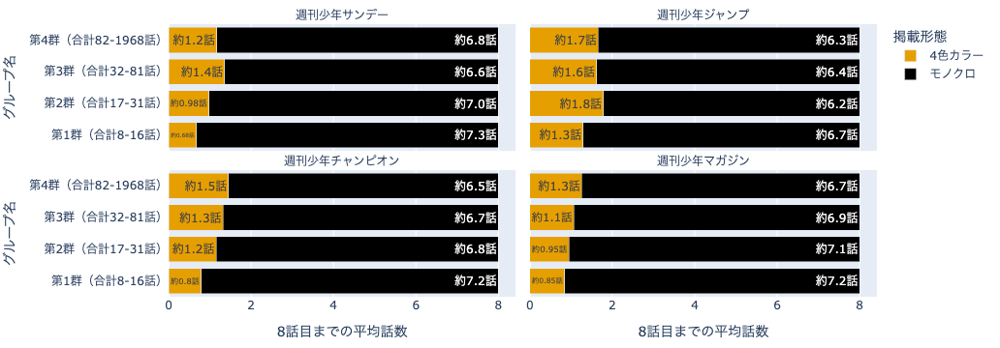

In [37]:
# df_sbar2データフレームを使用して積上げ棒グラフを作成
# f"{min_nce}話目までの平均話数"をx軸に、"グループ名"をy軸に設定
# 棒グラフのモードを"stack"（積み上げ）に設定し、"掲載形態"ごとに色分け
# 各棒には"text"をテキストとして表示
# "マンガ雑誌名"ごとにファセット（サブプロット）を作成し、2列でラップ
# 色はOKABE_ITOカラーパレットを利用するが、誤解を防ぐためモノクロが黒になるよう並び替え
# 棒グラフを水平方向に描画（orientation="h"）
fig = px.bar(
    df_sbar2,
    x=f"{min_nce}話目までの平均話数",
    y="グループ名",
    barmode="stack",
    color="掲載形態",
    orientation="h",
    text="text",
    facet_col="マンガ雑誌名",
    facet_col_wrap=2,
    color_discrete_sequence=OKABE_ITO[:2][::-1],
)

# ファセット（マンガ雑誌ごとの積上げ棒グラフ）のタイトルを簡潔にする処理
# デフォルトではタイトルは「マンガ雑誌名=xxx」という形式になっている
# この処理は「=」で文字列を分割して「xxx」の部分だけを取り出す
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))

# 作成した積上げ棒グラフを表示
show_fig(fig)

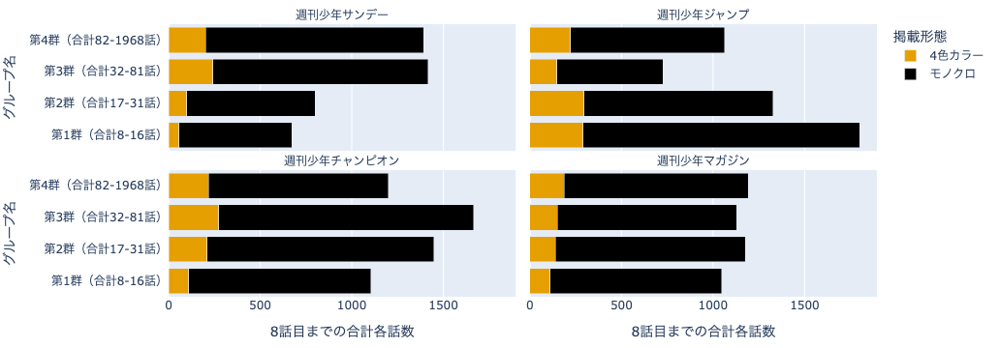

In [38]:
# df_sbar2データフレームを使用して積上げ棒グラフを作成
# f"{min_nce}話目までの合計各話数"をx軸に、"グループ名"をy軸に設定
# 棒グラフのモードを"stack"（積み上げ）に設定し、"掲載形態"ごとに色分け
# "マンガ雑誌名"ごとにファセット（サブプロット）を作成し、2列でラップ
# 色はOKABE_ITOカラーパレットを利用するが、誤解を防ぐためモノクロが黒になるよう並び替え
# 棒グラフを水平方向に描画（orientation="h"）
fig = px.bar(
    df_sbar2,
    x=f"{min_nce}話目までの合計各話数",
    y="グループ名",
    barmode="stack",
    color="掲載形態",
    orientation="h",
    facet_col="マンガ雑誌名",
    facet_col_wrap=2,
    color_discrete_sequence=OKABE_ITO[:2][::-1],
)

# ファセット（マンガ雑誌ごとの積上げ棒グラフ）のタイトルを簡潔にする処理
# デフォルトではタイトルは「マンガ雑誌名=xxx」という形式になっている
# この処理は「=」で文字列を分割して「xxx」の部分だけを取り出す
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))

# 作成した積上げ棒グラフを表示
show_fig(fig)

(cm-mos)=
### モザイクプロット

In [39]:
# 積上げ棒グラフと同じデータを利用
df_mos = df_sbar.copy()

In [40]:
# 可視化対象のDataFrameを確認
df_mos.head()

,グループ名,8話目までの合計各話数,count,掲載形態,8話目までの平均話数,text
0,第1群（合計8-16話）,569,578,4色カラー,0.984429,約0.98話
1,第1群（合計8-16話）,4055,578,モノクロ,7.015571,約7.0話
2,第2群（合計17-31話）,742,594,4色カラー,1.249158,約1.2話
3,第2群（合計17-31話）,4010,594,モノクロ,6.750842,約6.8話
4,第3群（合計32-81話）,814,617,4色カラー,1.319287,約1.3話


In [41]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_mos, DIR_OUT, "mos")

DataFrame is saved as '../../../data/cm/output/vol1/04/props/mos.csv'.


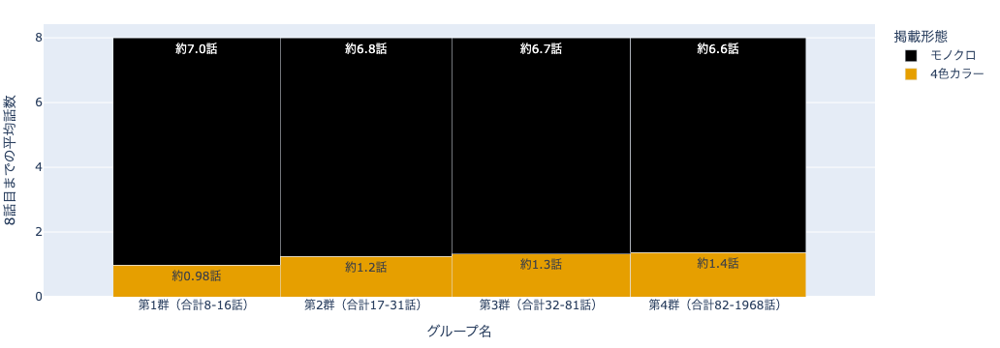

In [42]:
# df_mosを用いてモザイクプロットを作成
# x軸にはグループ名、y軸には8話目までの平均話数、色分けは掲載形態を指定
# 各セルの幅はcount列に基づき、各セルにはテキスト情報も表示
# 色はOKABE_ITOカラーパレットを利用するが、誤解を防ぐためモノクロが黒になるよう並び替え
fig = create_mosaicplot(
    df_mos,
    x="グループ名",
    y="8話目までの平均話数",
    color="掲載形態",
    width="count",
    text="text",
    color_discrete_sequence=OKABE_ITO[:2][::-1],
)

# 作成したモザイクプロットを表示
show_fig(fig)

In [43]:
# 雑誌別のグループごとのカラー各話数を集計したdf_sbar2を利用
df_mos2 = df_sbar2.copy()

# df_mos2からマンガ雑誌名が「週刊少年ジャンプ」のデータのみを抽出
df_mos2 = df_mos2[df_mos2["マンガ雑誌名"] == "週刊少年ジャンプ"]

In [44]:
# 可視化対象のDataFrameを確認
df_mos2.head()

,マンガ雑誌名,グループ名,8話目までの合計各話数,count,掲載形態,8話目までの平均話数,text
8,週刊少年ジャンプ,第1群（合計8-16話）,291,225,4色カラー,1.293333,約1.3話
9,週刊少年ジャンプ,第1群（合計8-16話）,1509,225,モノクロ,6.706667,約6.7話
10,週刊少年ジャンプ,第2群（合計17-31話）,296,166,4色カラー,1.783133,約1.8話
11,週刊少年ジャンプ,第2群（合計17-31話）,1032,166,モノクロ,6.216867,約6.2話
12,週刊少年ジャンプ,第3群（合計32-81話）,147,91,4色カラー,1.615385,約1.6話


In [45]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_mos2, DIR_OUT, "mos2")

DataFrame is saved as '../../../data/cm/output/vol1/04/props/mos2.csv'.


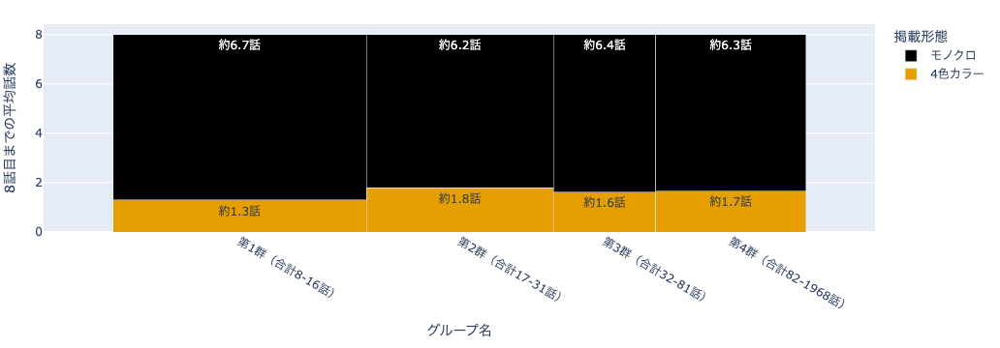

In [46]:
# x軸にはグループ名、y軸には8話目までの平均話数、色分けは掲載形態を指定
# 各セルの幅はcount列に基づき、各セルにはテキスト情報も表示
# 色はOKABE_ITOカラーパレットを利用するが、誤解を防ぐためモノクロが黒になるよう並び替え
fig = create_mosaicplot(
    df_mos2,
    x="グループ名",
    y="8話目までの平均話数",
    color="掲載形態",
    width="count",
    text="text",
    color_discrete_sequence=OKABE_ITO[:2][::-1],
)

# 作成したモザイクプロットを表示
show_fig(fig)

(cm-area)=
### 積上げ密度プロット[^area]

[^area]: 狭義には、確率密度を積上げたもののみを「積上げ密度プロット」と呼ぶこともあります。本書では便宜上、確率密度以外を対象とした場合も「積上げ密度プロット」と呼びます。

In [47]:
# 上位n_ccのマンガ作品を選択するための変数
n_cc = 5

In [48]:
# "ccid"でグループ化し、"four_colored"列の合計を計算
df_cc_n4c = df_ce.groupby(["ccid"])["four_colored"].sum().reset_index(name="n_4c")

# 4色カラーの合計数で降順にソートし、インデックスをリセット
df_cc_n4c = df_cc_n4c.sort_values("n_4c", ascending=False, ignore_index=True)

# 上位n_cc（5つ）のccidを選択し、リストとして取得
ccids = df_cc_n4c["ccid"].head(n_cc).to_list()

In [49]:
# 'date'列を日付型に変換し、その年部分を新しい'year'列として追加
df_ce["year"] = pd.to_datetime(df_ce["date"]).dt.year

# 各マンガ作品名と年ごとに4色カラーの合計、件数、平均を集計
df_cc_year_n4c = (
    df_ce.groupby(["ccname", "ccid", "year"])["four_colored"]
    .agg(["sum", "count", "mean"])
    .reset_index()
)

In [50]:
# ccid列がccidsリストに含まれている行のみを選択し、df_colorとして再定義
df_color = df_cc_year_n4c[df_cc_year_n4c["ccid"].isin(ccids)].reset_index(drop=True)
# color_type列に4色カラーを設定
df_color["color_type"] = "4色カラー"

# モノクロのデータを作成
df_mono = df_color.copy()
# モノクロの各話数は、合計各話数から4色カラーの合計を引いたもの
df_mono["sum"] = df_mono["count"] - df_mono["sum"]
# モノクロの平均は1から4色カラーの平均を引いたもの
df_mono["mean"] = 1 - df_mono["mean"]
# カラータイプに"モノクロ"を設定
df_mono["color_type"] = "モノクロ"

# 4色カラーとモノクロのデータを結合
df_area = pd.concat([df_color, df_mono], ignore_index=True)
# 'ccid'列をカテゴリ型に変換し、ccidsリストに基づいて順序付け
df_area["ccid"] = pd.Categorical(df_area["ccid"], categories=ccids, ordered=True)
# 'year', 'ccid', 'color_type'の順でソートし、インデックスをリセット
df_area = df_area.sort_values(["year", "ccid", "color_type"], ignore_index=True)

In [51]:
# px.areaで欠損値を自動補完されないように0埋めする処理

# df_areaからユニークなccnamesのリストを取得
ccnames = df_area["ccname"].unique()
# df_areaに含まれる年の範囲を取得（最小年から最大年まで）
years = range(df_area["year"].min(), df_area["year"].max() + 1)
# df_areaからユニークなcolor_type（色のタイプ）のリストを取得
color_types = df_area["color_type"].unique()

# ccname, year, color_typeの組み合わせごとにダミーの行を作成
# これによって、すべての可能な組み合わせをカバーする
df_dummy = pd.DataFrame(
    [
        {"ccname": ccname, "year": year, "color_type": ct}
        for ccname, year, ct in itertools.product(ccnames, years, color_types)
    ]
)

# 元のdf_areaとダミーデータフレームdf_dummyを結合
# 結合の基準はccname, year, color_typeの各カラム
df_area = pd.merge(df_area, df_dummy, on=["ccname", "year", "color_type"], how="outer")
# sumおよびmean列のNaNを0埋め
df_area["sum"] = df_area["sum"].fillna(0)
df_area["mean"] = df_area["mean"].fillna(0)

In [52]:
# 列名をよりわかりやすい名前に変更
df_area = df_area.rename(
    columns={
        "ccname": "マンガ作品名",
        "year": "掲載年",
        "sum": "各話数",
        "color_type": "掲載形態",
    }
)

In [53]:
# 可視化対象のDataFrameを確認
df_area.head()

,マンガ作品名,ccid,掲載年,各話数,count,mean,掲載形態
0,ドカベン,C95127,1972,22.0,34.0,0.647059,4色カラー
1,ドカベン,C95127,1972,12.0,34.0,0.352941,モノクロ
2,ドカベン,C95127,1973,21.0,49.0,0.428571,4色カラー
3,ドカベン,C95127,1973,28.0,49.0,0.571429,モノクロ
4,ドカベン,C95127,1974,19.0,49.0,0.387755,4色カラー


In [54]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_area, DIR_OUT, "area")

DataFrame is saved as '../../../data/cm/output/vol1/04/props/area.csv'.


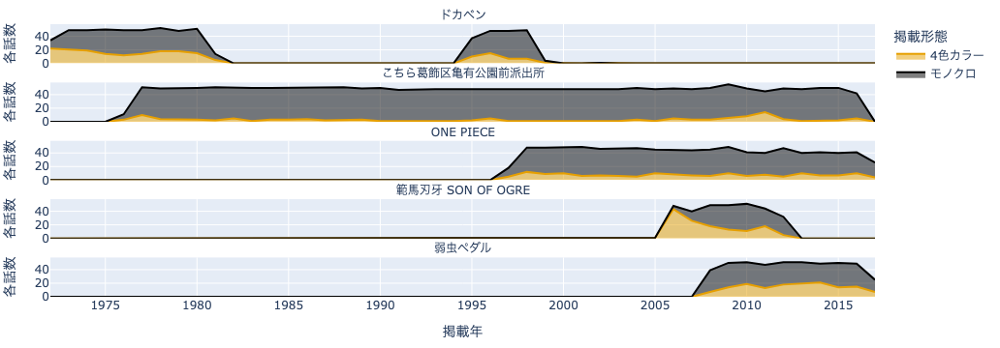

In [55]:
# df_areaデータフレームを使用して積上げ密度プロットを作成
# "掲載年"をx軸に、"各話数"をy軸に設定
# "掲載形態"ごとに色分けし、"マンガ作品名"ごとにファセット（サブプロット）を作成
# facet_col_wrap=1で各ファセットを1列に配置
# 色はOKABE_ITOカラーパレットの最初の2色を逆順で使用
fig = px.area(
    df_area,
    x="掲載年",
    y="各話数",
    color="掲載形態",
    facet_col="マンガ作品名",
    facet_col_wrap=1,
    color_discrete_sequence=OKABE_ITO[:2][::-1],
)

# hovermodeをx unifiedにすることで、同じxの値に対する全てのyの値を表示
fig.update_layout(hovermode="x unified")

# 各サブプロットの注釈（ファセットタイトル）を更新して、"マンガ作品名"の値のみ表示
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))

# 作成した積上げ密度プロットを表示
show_fig(fig)

(cm-tree)=
### ツリーマップ

In [56]:
# df_cc_nceからユニークなccidのリストを作成
ccids = list(df_cc_nce["ccid"].unique())

# df_ceからccid列がccidsリストに含まれ、four_coloredがTrueのデータのみを抽出
# reset_index(drop=True)を使って、インデックスをリセット（古いインデックスを削除）
df_tree = df_ce[df_ce["ccid"].isin(ccids) & df_ce["four_colored"]].reset_index(
    drop=True
)

# 必要な列のみ保持
df_tree = df_tree[["mcname", "ccname", "cename", "four_colored"]]

In [57]:
# 可視化対象のDataFrameを確認
df_tree.head()

,mcname,ccname,cename,four_colored
0,週刊少年マガジン,ダイヤのA,第238話/この世代,True
1,週刊少年マガジン,我間乱 ～GAMARAN～,第94話,True
2,週刊少年マガジン,ファイ・ブレイン 最期のパズル,第1話 クラシック同好会,True
3,週刊少年マガジン,かってに改蔵,特別番外編 「損して得とれない」,True
4,週刊少年マガジン,FAIRY TAIL,第231話 終わらせる者,True


In [58]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_tree, DIR_OUT, "tree")

DataFrame is saved as '../../../data/cm/output/vol1/04/props/tree.csv'.


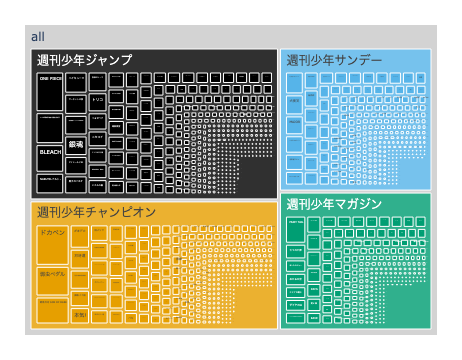

In [59]:
# df_treeを使ってツリーマップを作成
# 階層は"all" → "mcname" → "ccname"の順であり、サイズは"four_colored"の値によって決定
# color_discrete_sequenceで色の配列を設定（OKABE_ITO配色を使用）
fig = px.treemap(
    df_tree,
    path=[px.Constant("all"), "mcname", "ccname"],
    values="four_colored",
    color_discrete_sequence=OKABE_ITO,
)

# ツリーマップの根元の色を薄灰色に設定
fig.update_traces(root_color="lightgrey")

# 作成したツリーマップを表示
show_fig(fig)

(cm-par)=
### パラレルセットグラフ

In [60]:
# df_ceからminameが重複していないデータのみを抽出し、インデックスをリセット
df_par = df_ce.drop_duplicates(subset="miname").reset_index(drop=True)

# 年代情報をdf_parに追加
df_par = add_years_to_df(df_par)
# 曜日情報をdf_parに追加
df_par = add_weekday_to_df(df_par)
# 曜日、年代、mcname（雑誌名）の順でデータをソートし、インデックスをリセット
df_par = df_par.sort_values(["weekday", "years", "mcname"], ignore_index=True)

# 可視化用に保持するカラム
cols2rename = {
    "mcname": "雑誌名",
    "years": "年代",
    "weekday_str": "発売曜日",
    "weekday": "weekday",
}
# カラム名をよりわかりやすい名前に変更
df_par = format_cols(df_par, cols2rename)

In [61]:
# 可視化対象のDataFrameを確認
df_par.head()

,雑誌名,年代,発売曜日,weekday
0,週刊少年サンデー,1970,月,0
1,週刊少年サンデー,1970,月,0
2,週刊少年ジャンプ,1970,月,0
3,週刊少年ジャンプ,1970,月,0
4,週刊少年ジャンプ,1970,月,0


In [62]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_par, DIR_OUT, "par")

DataFrame is saved as '../../../data/cm/output/vol1/04/props/par.csv'.


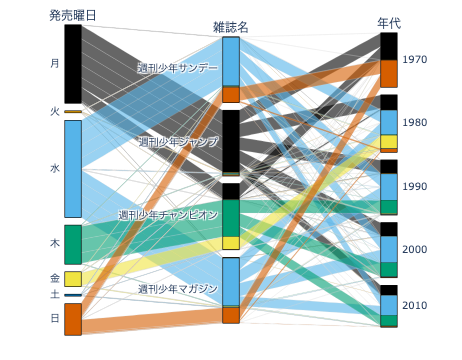

In [63]:
# df_parを使ってパラレルセットグラフを作成
# このプロットは「発売曜日」、「雑誌名」、「年代」を次元として可視化する
# 色分けは曜日（'weekday'）に基づいており、カラースケールはOKABE_ITOの最初の7色を使用
fig = px.parallel_categories(
    df_par,
    dimensions=["発売曜日", "雑誌名", "年代"],
    color="weekday",
    color_continuous_scale=OKABE_ITO[:7],
)

# カラースケールを非表示に設定
fig.update_coloraxes(showscale=False)

# 作成したパラレルセットグラフを表示
show_fig(fig)